D:\anaconda\lib\site-packages\tensorflow_addons\utils\tfa_eol_msg.py:23: UserWarning: 

TensorFlow Addons (TFA) has ended development and introduction of new features.
TFA has entered a minimal maintenance and release mode until a planned end of life in May 2024.
Please modify downstream libraries to take dependencies from other repositories in our TensorFlow community (e.g. Keras, Keras-CV, and Keras-NLP). 

For more information see: https://github.com/tensorflow/addons/issues/2807 

  warnings.warn(
D:\anaconda\lib\site-packages\tensorflow_addons\utils\ensure_tf_install.py:53: UserWarning: Tensorflow Addons supports using Python ops for all Tensorflow versions above or equal to 2.12.0 and strictly below 2.15.0 (nightly versions are not supported). 
 The versions of TensorFlow you are currently using is 2.9.1 and is not supported. 
Some things might work, some things might not.
If you were to encounter a bug, do not file an issue.
If you want to make sure you're using a tested and sup

loading Food-101
DatasetDict({
    train: Dataset({
        features: ['image', 'label'],
        num_rows: 75750
    })
    validation: Dataset({
        features: ['image', 'label'],
        num_rows: 25250
    })
})
samples of train: 75750
samples of test: 25250
label number: 101

 random labels:
label ID: 57
label name: hummus


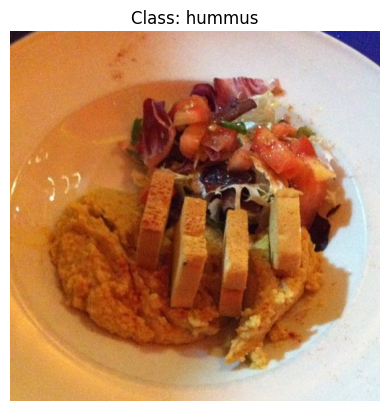

In [2]:
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt
import random
import warnings
from PIL import Image
import tensorflow_addons as tfa
from datasets import load_dataset

# random seeds to ensure repeatability
SEED = 42
random.seed(SEED)
np.random.seed(SEED)
tf.random.set_seed(SEED)

# hide warning
warnings.filterwarnings('ignore')

# creat output folder
import os
os.makedirs('outputs', exist_ok=True)

# load dataset through HuggingFace Datasets
print("loading Food-101")
dataset = load_dataset("ethz/food101")

# check
print(dataset)

print(f"samples of train: {len(dataset['train'])}")
print(f"samples of test: {len(dataset['validation'])}")

# get label
food_classes = dataset['train'].features['label'].names
num_classes = len(food_classes)
print(f"label number: {num_classes}")

sample_idx = random.randint(0, len(dataset['train']) - 1)
sample = dataset['train'][sample_idx]
label_id = sample['label']
label_name = food_classes[label_id]

print("\n random labels:")
print(f"label ID: {label_id}")
print(f"label name: {label_name}")

# load img
img = sample['image']
plt.imshow(img)
plt.axis('off')
plt.title(f"Class: {label_name}")
plt.show()




begin
number of error img: 103


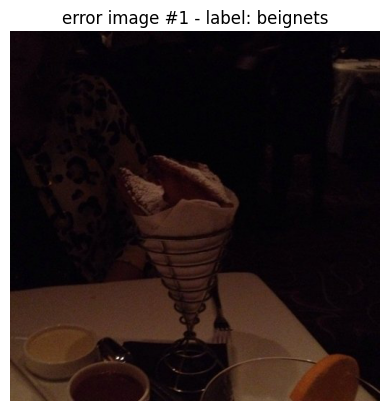

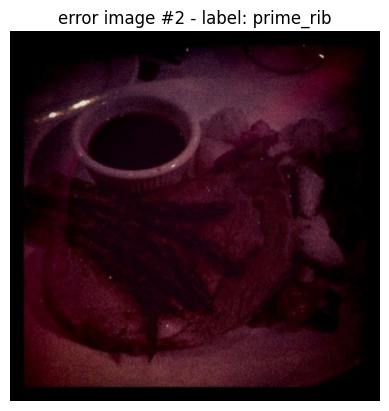

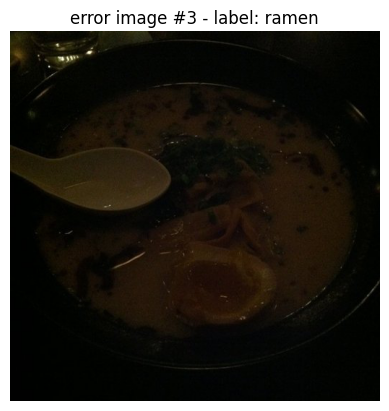

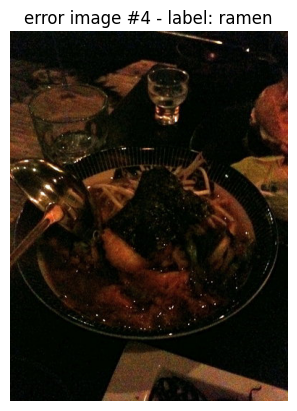

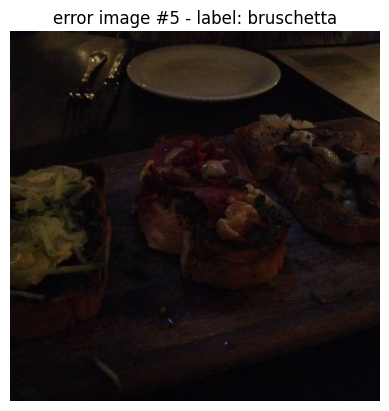

...

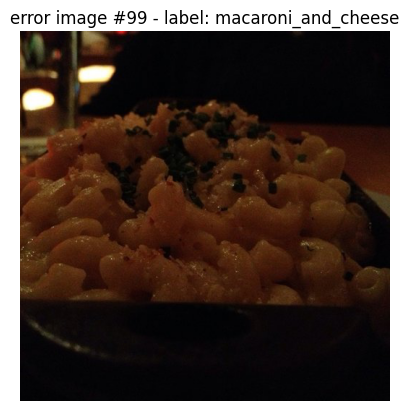

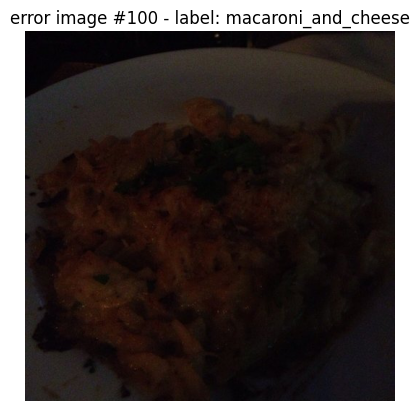

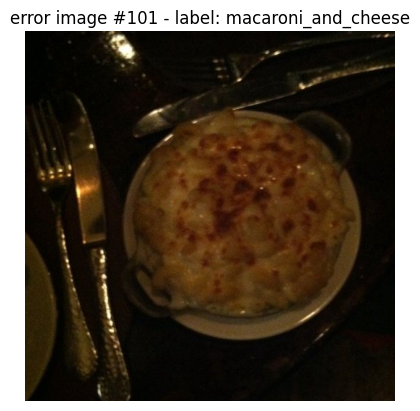

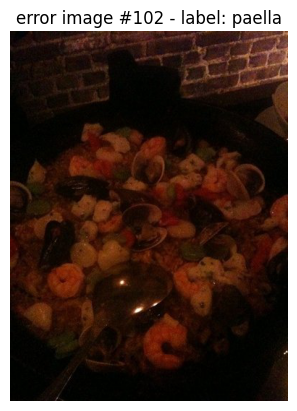

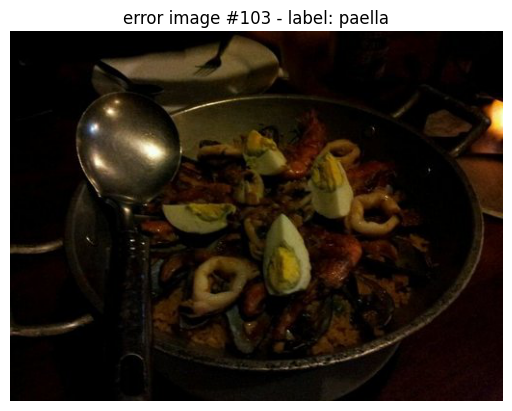

In [16]:
def is_abnormal_color(image_array, brightness_thresh=(0.1, 0.9), std_thresh=0.05):
    mean_brightness = np.mean(image_array)
    std = np.std(image_array)

    if mean_brightness < brightness_thresh[0] or mean_brightness > brightness_thresh[1]:
        return True
    if std < std_thresh:
        return True
    return False
error_sample = []

print("begin")
for idx in range(len(dataset['train'])):
    sample = dataset['train'][idx]
    label_idx = sample['label']
    label_nm = food_classes[label_idx]
    img = sample['image']
    
    # Normalization 
    img_array = np.array(img).astype(np.float32) / 255.0
    
    if is_abnormal_color(img_array):
        error_sample.append({
            'index': idx,
            'label_id': label_idx,
            'label_name': label_nm
        })

print(f"number of error img: {len(error_sample)}")

for i, sample_info in enumerate(error_sample[:103]):
    idx = sample_info['index']
    img = dataset['train'][idx]['image']
    label = sample_info['label_name']
    
    plt.figure()
    plt.imshow(img)
    plt.axis('off')
    plt.title(f"error image #{i+1} - label: {label}")
    plt.savefig(f"outputs/abnormal_sample_{i+1}.png")
    plt.show()


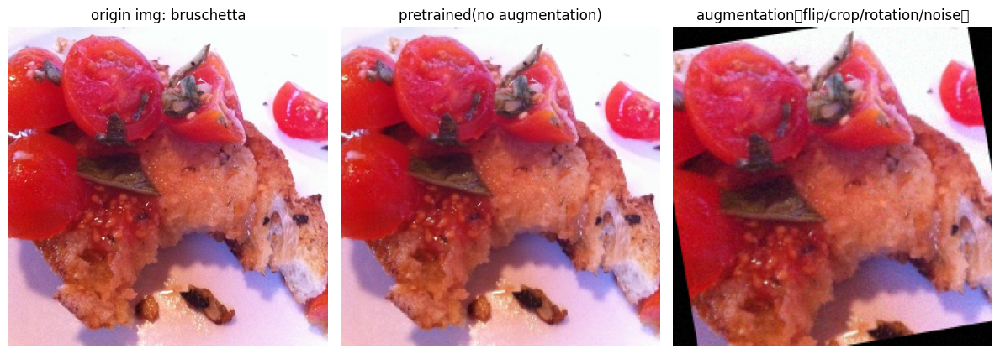


 check images...
Image width range: 440-512, ave: 504.8
Image height range: 306-512, ave: 478.6
channels of images: {3}


In [4]:
def preprocess_image(image, target_size=(224, 224), augment=True):
    """
    pretrian   
    return:
    - TensorFlow，[0,1]
    """
    if isinstance(image, Image.Image):
        image = np.array(image)
    
    if len(image.shape) == 2:
        image = np.stack([image] * 3, axis=-1)
    elif image.shape[-1] == 4:
        image = image[:, :, :3]

    # tensorflow
    image = tf.convert_to_tensor(image, dtype=tf.float32)

    # augmentation
    if augment:
        # horizontal flip
        image = tf.image.random_flip_left_right(image)

        # Flip up and down
        image = tf.image.random_flip_up_down(image)

        # resize + random crop
        resize_scale = int(target_size[0] * 1.2)
        image = tf.image.resize(image, [resize_scale, resize_scale])
        image = tf.image.random_crop(image, size=[target_size[0], target_size[1], 3])
        
        # random rotation
        angle = tf.random.uniform([], minval=-0.35, maxval=0.35)  # 20°
        image = tfa.image.rotate(image, angles=angle, interpolation='BILINEAR')

        # add guassian noise
        noise = tf.random.normal(shape=tf.shape(image), mean=0.0, stddev=5.0)
        image = tf.clip_by_value(image + noise, 0.0, 255.0)

    else:
        # resize
        image = tf.image.resize(image, target_size)

    # Standardized to [0,1]
    image = tf.cast(image, tf.float32) / 255.0
    return image


# Reselect the sample and enhance it
sample_idx = random.randint(0, len(dataset['train'])-1)
sample_image = dataset['train'][sample_idx]['image']
sample_label = dataset['train'][sample_idx]['label']
sample_class = food_classes[sample_label]

# Processing original and enhanced images 
processed_no_aug = preprocess_image(sample_image, augment=False)
processed_aug = preprocess_image(sample_image, augment=True)

plt.figure(figsize=(12, 6))

plt.subplot(1, 3, 1)
plt.imshow(sample_image)
plt.title(f"origin img: {sample_class}")
plt.axis('off')

plt.subplot(1, 3, 2)
plt.imshow(processed_no_aug)
plt.title("pretrained(no augmentation)")
plt.axis('off')

plt.subplot(1, 3, 3)
plt.imshow(processed_aug)
plt.title("augmentation（flip/crop/rotation/noise）")
plt.axis('off')

plt.tight_layout()
plt.savefig("outputs/preprocessing_with_augmentation.png")
plt.show()

print("\n check images...")
widths, heights, channels = [], [], []
for i in range(10):
    idx = random.randint(0, len(dataset['train'])-1)
    img = dataset['train'][idx]['image']
    img_array = np.array(img)
    
    widths.append(img.width)
    heights.append(img.height)
    
    if len(img_array.shape) == 2:
        channels.append(1)  # gray
    else:
        channels.append(img_array.shape[2])  # RGB/RGBA

print(f"Image width range: {min(widths)}-{max(widths)}, ave: {sum(widths)/len(widths):.1f}")
print(f"Image height range: {min(heights)}-{max(heights)}, ave: {sum(heights)/len(heights):.1f}")
print(f"channels of images: {set(channels)}")

In [10]:
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt
import random
from datasets import load_dataset

# load dataset through HuggingFace Datasets）
print("loading Food-101")
dataset = load_dataset("ethz/food101")

food_classes = dataset['train'].features['label'].names

def preprocess_image(image, target_size=(224, 224)):

    # - image: PIL or numpy
    # - target_size: 224x224
    
    # return:（TensorFlow，0→1）

    if isinstance(image, Image.Image):
        image = np.array(image)
    
    if len(image.shape) == 2:
        image = np.stack([image] * 3, axis=-1)
    elif image.shape[-1] == 4:
        image = image[:, :, :3]

    # Convert to TensorFlow tensor
    image = tf.convert_to_tensor(image, dtype=tf.float32)

    # resize
    image = tf.image.resize(image, target_size)

    # normalization [0,1]
    image = tf.cast(image, tf.float32) / 255.0
    return image

# build TensorFlow dataset
def create_tf_dataset(dataset, batch_size=32, target_size=(224, 224)):

    #- dataset: HuggingFace Dataset
    #- batch_size
    #- target_size: Target size of the image
    
    #return: TensorFlow dataset （batch_size)

    def gen():
        for sample in dataset['train']:
            image = sample['image']
            label = sample['label']
            processed_image = preprocess_image(image, target_size)
            yield processed_image, label

    tf_dataset = tf.data.Dataset.from_generator(gen, output_signature=(
        tf.TensorSpec(shape=(target_size[0], target_size[1], 3), dtype=tf.float32),
        tf.TensorSpec(shape=(), dtype=tf.int64)
    ))

    # Batch and prefetch (improve performance)
    tf_dataset = tf_dataset.batch(batch_size).prefetch(tf.data.experimental.AUTOTUNE)

    return tf_dataset

batch_size = 32
target_size = (224, 224)
train_dataset = create_tf_dataset(dataset, batch_size, target_size)

# check value range,label type and label example
for images, labels in train_dataset.take(1):
    print(f"value range: [{tf.reduce_min(images).numpy()}, {tf.reduce_max(images).numpy()}]")
    print(f"label type: {labels.dtype}")
    print(f"label example: {labels.numpy()[:5]}")
    
# Check the shape of the dataset (first few batches)
for images, labels in train_dataset.take(1):
    print(f"Batch shape: {images.shape}, Labels shape: {labels.shape}")



loading Food-101
value range: [0.0, 1.0]
label type: <dtype: 'int64'>
label example: [6 6 6 6 6]
Batch shape: (32, 224, 224, 3), Labels shape: (32,)
